In [1]:
import pandas as pd
import numpy as np
import scipy
import seaborn as sns
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import random
import pathlib
import torch
from torchvision import datasets
import torchvision.transforms as transforms
from torchvision.io import read_image
from torch.utils.data import Dataset
from torchvision.transforms import ToTensor
from torch.utils.data import DataLoader
import os
import cv2
import glob
from skimage import io
from skimage.metrics import structural_similarity as ssim
from statsmodels.stats.diagnostic import lilliefors
from scipy.stats import mannwhitneyu 

In [83]:
df = pd.read_csv("./../Datasets/Dataset_BUSI_with_GT_postprocessed_224/mapping.csv")
df['img_path'][0]

'./Datasets/Dataset_BUSI_with_GT_postprocessed_224/images/benign_id_1.png'

# Image similarity analysis

## MSE

In [23]:
mses = np.zeros(shape=(len(df['img_path']), len(df['img_path'])))
for n, i in enumerate(df['img_path']):
    for m, o in enumerate(df['img_path']):
        if n > m:
            img_in = cv2.imread('./.' + i, 0)
            img_out = cv2.imread('./.' + o, 0)

            mses[n, m] = round(np.mean((img_in - img_out) ** 2),1)
        else:
            mses[n, m] = np.nan


In [24]:
mses.shape

(780, 780)

In [25]:
mses

array([[  nan,   nan,   nan, ...,   nan,   nan,   nan],
       [ 99.3,   nan,   nan, ...,   nan,   nan,   nan],
       [ 99.8, 102.5,   nan, ...,   nan,   nan,   nan],
       ...,
       [104. , 107. , 101.9, ...,   nan,   nan,   nan],
       [106.2, 104.7, 106.1, ..., 105.6,   nan,   nan],
       [106.1, 107.9, 100.5, ...,  96.3, 109.9,   nan]])

In [26]:
mses_norm = mses/np.nanmax(mses)
mses_norm

array([[       nan,        nan,        nan, ...,        nan,        nan,
               nan],
       [0.87798408,        nan,        nan, ...,        nan,        nan,
               nan],
       [0.88240495, 0.90627763,        nan, ...,        nan,        nan,
               nan],
       ...,
       [0.91954023, 0.94606543, 0.90097259, ...,        nan,        nan,
               nan],
       [0.93899204, 0.92572944, 0.93810787, ..., 0.933687  ,        nan,
               nan],
       [0.93810787, 0.95402299, 0.88859416, ..., 0.85145889, 0.97170645,
               nan]])

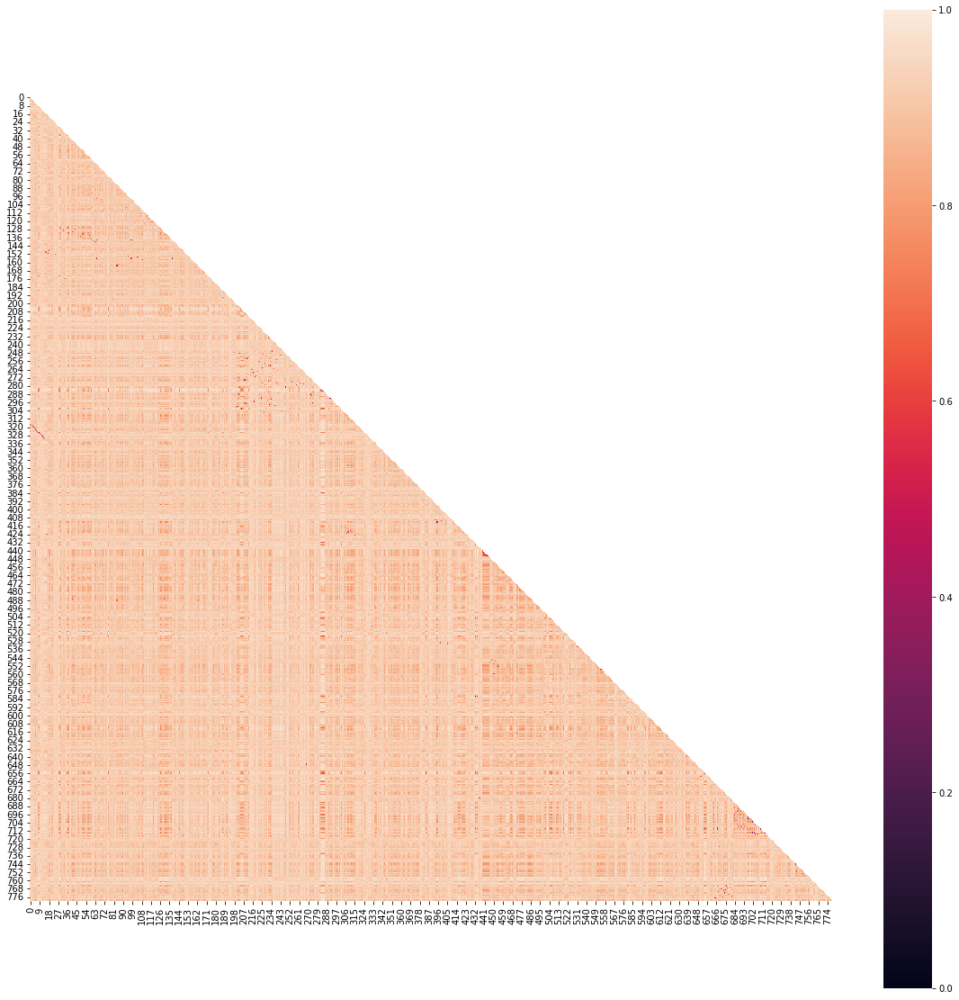

In [27]:
# with sns.axes_style("white"):
plt.figure(figsize=(20,20))
ax = sns.heatmap(mses_norm, square=True) # cmap="YlGnBu"
plt.show()

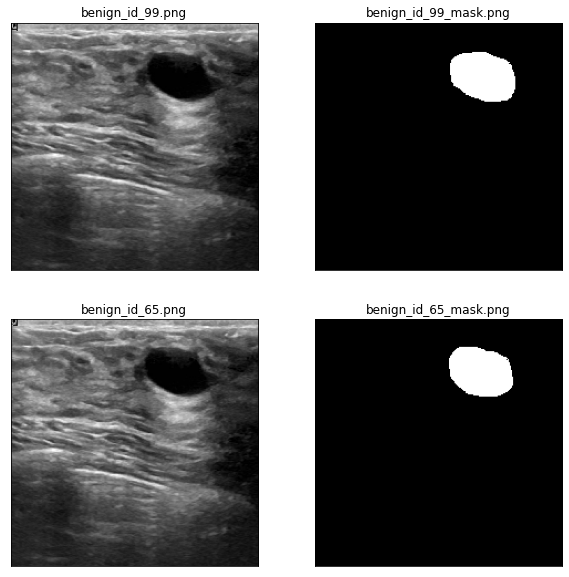

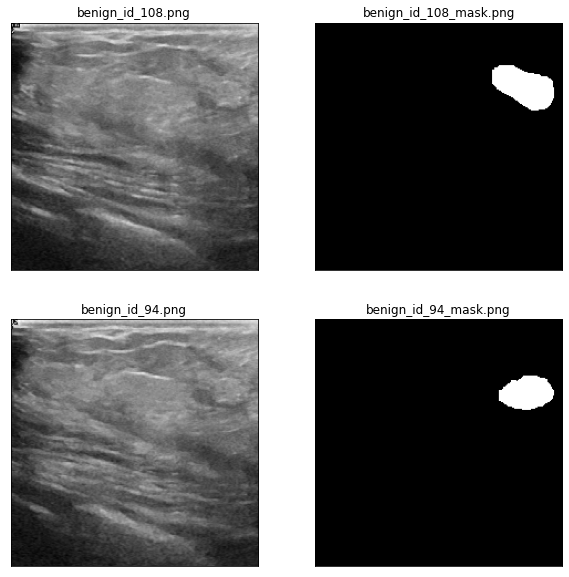

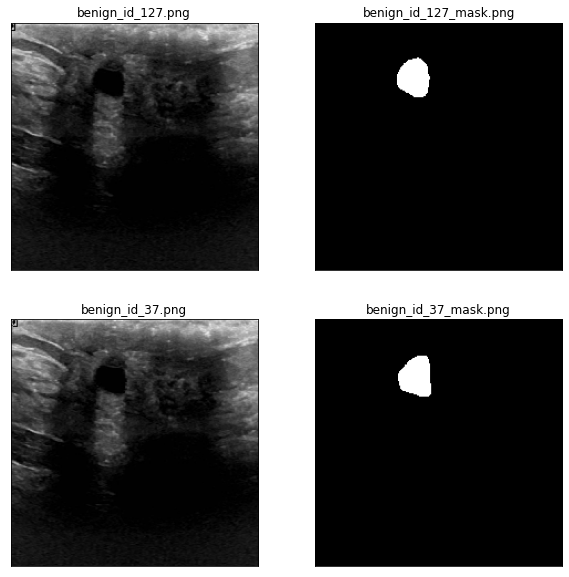

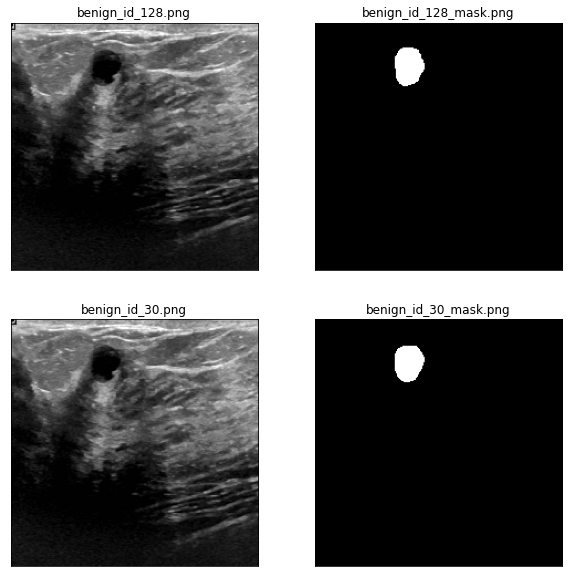

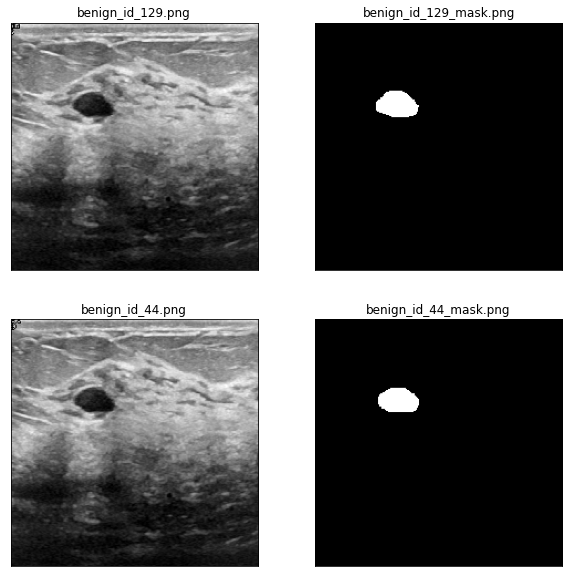

...

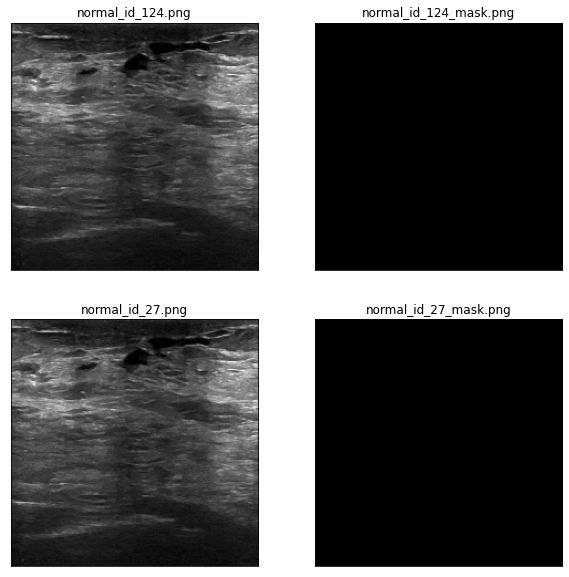

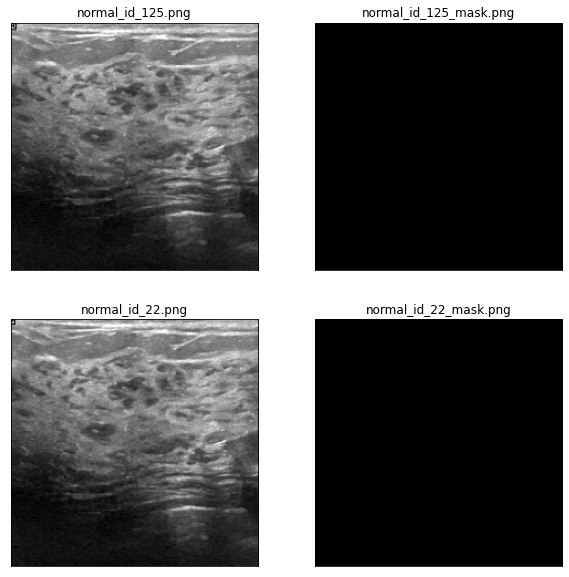

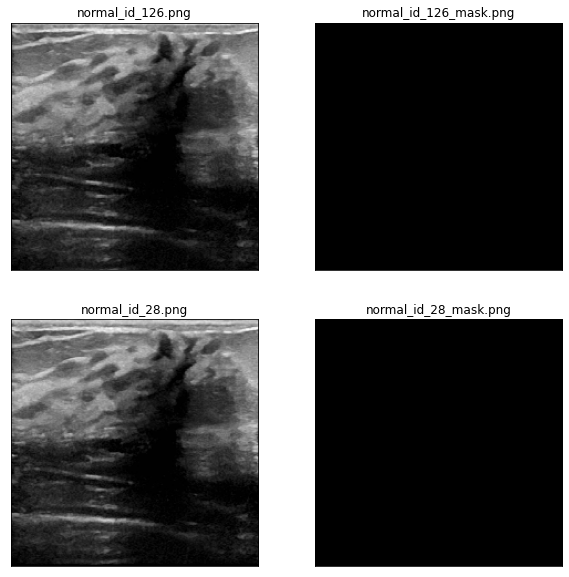

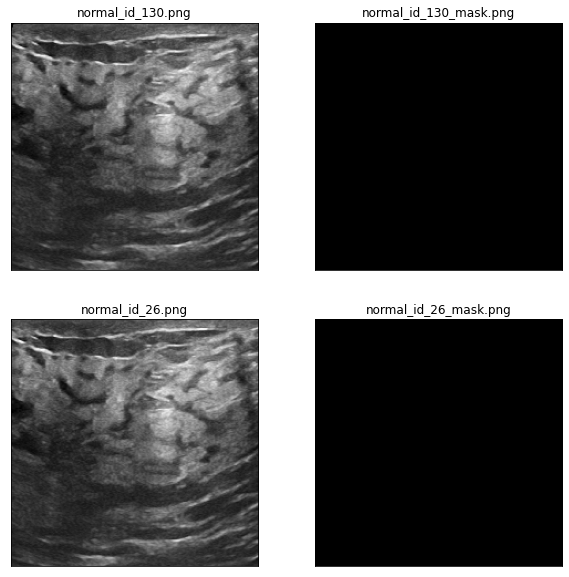

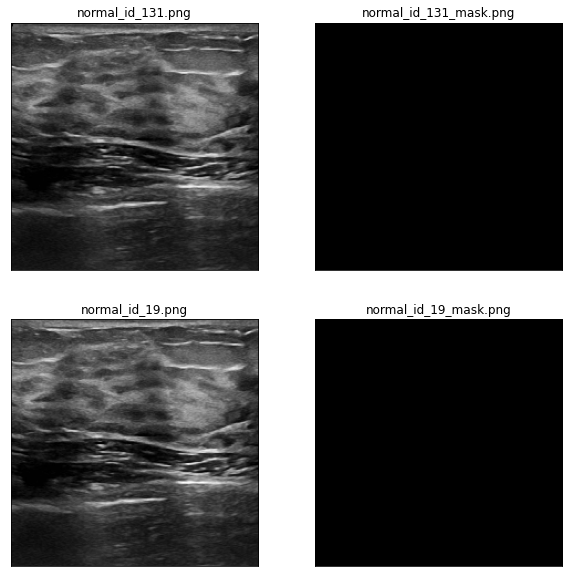

In [34]:
# get the indices where values are greater than 1
left, right = np.where((mses_norm < .621)) # top 150 similar images
pairs = []
for i, j in zip(left, right):
    
    image_1 = cv2.imread("./." + df['img_path'][i], 0)
    mask_1 = cv2.imread("./." + df['mask_path'][i], 0)
    image_2 = cv2.imread("./." + df['img_path'][j], 0)
    mask_2 = cv2.imread("./." + df['mask_path'][j], 0)


    # create a 2x2 grid of subplots
    fig, axs = plt.subplots(2, 2, figsize=(10, 10))

    # plot each image in a separate subplot
    axs[0, 0].imshow(image_1, cmap='gray')
    axs[0, 1].imshow(mask_1, cmap='gray')
    axs[1, 0].imshow(image_2, cmap='gray')
    axs[1, 1].imshow(mask_2, cmap='gray')

    # set the title for each subplot
    axs[0, 0].set_title(df['img_path'][i].split("/")[-1])
    axs[0, 1].set_title(df['mask_path'][i].split("/")[-1])
    axs[1, 0].set_title(df['img_path'][j].split("/")[-1])
    axs[1, 1].set_title(df['mask_path'][j].split("/")[-1])

    # hide the x and y ticks for each subplot
    for ax in axs.flat:
        ax.set_xticks([])
        ax.set_yticks([])

    # show the plot
    plt.show()

    print("\n\n\n")
    pairs.append([df['img_path'][i], df['img_path'][j]])
    
    

# pairs

In [35]:
pairs

[['./Datasets/Dataset_BUSI_with_GT_postprocessed_224/images/benign_id_99.png',
  './Datasets/Dataset_BUSI_with_GT_postprocessed_224/images/benign_id_65.png'],
 ['./Datasets/Dataset_BUSI_with_GT_postprocessed_224/images/benign_id_108.png',
  './Datasets/Dataset_BUSI_with_GT_postprocessed_224/images/benign_id_94.png'],
 ['./Datasets/Dataset_BUSI_with_GT_postprocessed_224/images/benign_id_127.png',
  './Datasets/Dataset_BUSI_with_GT_postprocessed_224/images/benign_id_37.png'],
 ['./Datasets/Dataset_BUSI_with_GT_postprocessed_224/images/benign_id_128.png',
  './Datasets/Dataset_BUSI_with_GT_postprocessed_224/images/benign_id_30.png'],
 ['./Datasets/Dataset_BUSI_with_GT_postprocessed_224/images/benign_id_129.png',
  './Datasets/Dataset_BUSI_with_GT_postprocessed_224/images/benign_id_44.png'],
 ['./Datasets/Dataset_BUSI_with_GT_postprocessed_224/images/benign_id_131.png',
  './Datasets/Dataset_BUSI_with_GT_postprocessed_224/images/benign_id_42.png'],
 ['./Datasets/Dataset_BUSI_with_GT_postpr

In [6]:
df

,img_path,mask_path,class,id,dim1,dim2,tumor_pixels,y_max,y_min,x_max,x_min,y_size,x_size
0,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,benign,1,224,224,195,77,64,136,115,13,21
1,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,benign,2,224,224,1792,144,107,107,42,37,65
2,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,benign,3,224,224,1344,103,69,182,129,34,53
3,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,benign,4,224,224,505,75,55,137,34,20,103
4,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,benign,5,224,224,630,113,86,121,91,27,30
...,...,...,...,...,...,...,...,...,...,...,...,...,...
775,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,normal,129,224,224,0,0,0,0,0,0,0
776,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,normal,130,224,224,0,0,0,0,0,0,0
777,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,normal,131,224,224,0,0,0,0,0,0,0
778,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,normal,132,224,224,0,0,0,0,0,0,0


## Structural similarity

In [84]:
# calculating SSIM pairwise
ssmis = np.zeros(shape=(len(df['img_path']), len(df['img_path'])))
for n, i in enumerate(df['img_path']):
    for m, o in enumerate(df['img_path']):

        img_in = cv2.imread('./.' + i, 0)
        img_out = cv2.imread('./.' + o, 0)

        ssmis[n, m] = ssim(img_in, img_out, data_range=img_out.max() - img_out.min())


In [85]:
ssmis

array([[1.        , 0.13769948, 0.15776737, ..., 0.13988275, 0.08547574,
        0.15624734],
       [0.13769948, 1.        , 0.12552779, ..., 0.10742346, 0.08756282,
        0.12609996],
       [0.15776737, 0.12552779, 1.        , ..., 0.14084217, 0.08420061,
        0.19166442],
       ...,
       [0.14937148, 0.11582695, 0.15081623, ..., 1.        , 0.09516381,
        0.18787271],
       [0.11323727, 0.11338629, 0.11186038, ..., 0.11349982, 1.        ,
        0.11275311],
       [0.15624734, 0.12609996, 0.19166442, ..., 0.17559075, 0.08387747,
        1.        ]])

In [86]:
# select all values above the diagonal (excluding diag)
upper_diag = np.mean(ssmis[np.triu_indices(ssmis.shape[0], k = 1)])

# select all values below the diagonal (excluding diag)
lower_diag = np.mean(ssmis[np.tril_indices(ssmis.shape[0], k = 1)])

# replacing diagonal by NaN
np.fill_diagonal(ssmis, np.nan)

In [87]:
names = df['id'].astype(str) + "_" + df['class'].astype(str)
ssmis_df = pd.DataFrame(ssmis, columns=names, index=names)
ssmis_df

,1_benign,2_benign,3_benign,4_benign,5_benign,6_benign,7_benign,8_benign,9_benign,10_benign,...,124_normal,125_normal,126_normal,127_normal,128_normal,129_normal,130_normal,131_normal,132_normal,133_normal
1_benign,NaN,0.137699,0.157767,0.152061,0.141266,0.132283,0.185373,0.178451,0.062542,0.117480,...,0.123844,0.138643,0.082130,0.110703,0.119352,0.129012,0.084042,0.139883,0.085476,0.156247
2_benign,0.137699,NaN,0.125528,0.129791,0.116996,0.113515,0.138032,0.126085,0.044115,0.102122,...,0.106418,0.118274,0.097264,0.098463,0.091608,0.103640,0.074709,0.107423,0.087563,0.126100
3_benign,0.157767,0.125528,NaN,0.146515,0.133138,0.156275,0.164597,0.173439,0.070274,0.110128,...,0.132742,0.168029,0.111664,0.098938,0.138305,0.107725,0.105179,0.140842,0.084201,0.191664
4_benign,0.152061,0.129791,0.146515,NaN,0.121016,0.134588,0.183677,0.174933,0.069536,0.134585,...,0.149533,0.160693,0.121432,0.114336,0.125027,0.130502,0.090455,0.135900,0.083758,0.158102
5_benign,0.141266,0.116996,0.133138,0.121016,NaN,0.161256,0.167651,0.167269,0.080260,0.119997,...,0.127242,0.136703,0.106154,0.116243,0.126400,0.131853,0.107922,0.129424,0.089169,0.187809
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
129_normal,0.130854,0.105370,0.109699,0.132571,0.133922,0.186595,0.167988,0.181417,0.077891,0.122773,...,0.192839,0.145873,0.135011,0.117398,0.157335,NaN,0.123902,0.154888,0.066326,0.187454
130_normal,0.106857,0.095408,0.130446,0.113192,0.134361,0.184880,0.148793,0.162858,0.077811,0.091189,...,0.146348,0.150235,0.102748,0.116870,0.140239,0.149394,NaN,0.134747,0.075711,0.182490
131_normal,0.149371,0.115827,0.150816,0.145914,0.140368,0.205977,0.169750,0.170283,0.082835,0.102679,...,0.163345,0.179382,0.121086,0.102608,0.142136,0.164373,0.120272,NaN,0.095164,0.187873
132_normal,0.113237,0.113386,0.111860,0.111415,0.118490,0.095822,0.136717,0.123052,0.063157,0.089766,...,0.112843,0.118757,0.096507,0.099741,0.085780,0.093733,0.084580,0.113500,NaN,0.112753


In [22]:
top_5_df = []
for c in ssmis_df.columns:
    top_5 = ssmis_df.sort_values(by=c, ascending=False)[c].head(11).reset_index()
    images = top_5['index'].tolist()
    values = top_5[c].tolist()
    
    top_5_df.append(pd.DataFrame([images + values]))


top_5_df = pd.concat(top_5_df)
top_5_df.columns = ['image_reference', 'top_1', 'top_2', 'top_3', 'top_4', 'top_5', 'top_6', 'top_7', 'top_8', 
                    'top_9', 'top_10', 'value_reference', 'value_1', 'value_2', 'value_3', 'value_4', 'value_5', 
                    'value_6', 'value_7', 'value_8', 'value_9', 'value_10']
top_5_df.drop(columns='value_reference', inplace=True)
top_5_df.reset_index(drop=True, inplace=True)
top_5_df

,image_reference,top_1,top_2,top_3,top_4,top_5,top_6,top_7,top_8,top_9,...,value_1,value_2,value_3,value_4,value_5,value_6,value_7,value_8,value_9,value_10
0,318_benign,117_malignant,119_benign,116_benign,122_benign,114_benign,3_malignant,7_benign,108_benign,338_benign,...,0.202663,0.202404,0.202078,0.193532,0.189333,0.189095,0.185373,0.185328,0.183129,0.181186
1,319_benign,154_malignant,21_benign,114_benign,122_benign,34_malignant,3_malignant,74_benign,199_malignant,61_malignant,...,0.162633,0.159130,0.157569,0.152292,0.152160,0.147217,0.143098,0.143014,0.142828,0.142648
2,320_benign,3_malignant,116_malignant,18_malignant,7_malignant,170_malignant,411_benign,111_benign,5_malignant,93_malignant,...,0.199222,0.197616,0.196770,0.196200,0.194650,0.194360,0.193850,0.193675,0.192177,0.191664
3,321_benign,48_malignant,394_benign,7_malignant,395_benign,426_benign,115_malignant,70_normal,316_benign,7_benign,...,0.193464,0.187972,0.187952,0.187701,0.186022,0.185050,0.184783,0.183965,0.183677,0.183603
4,322_benign,399_benign,93_malignant,117_malignant,133_normal,114_benign,108_benign,269_benign,411_benign,116_benign,...,0.205883,0.204341,0.189805,0.187809,0.186274,0.185326,0.183500,0.182817,0.182100,0.182071
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
775,35_normal,37_malignant,181_malignant,36_malignant,18_malignant,116_malignant,208_malignant,115_malignant,14_malignant,335_benign,...,0.243908,0.235137,0.231620,0.224831,0.220814,0.216465,0.210504,0.210247,0.209602,0.209462
776,26_normal,3_malignant,18_malignant,116_malignant,85_malignant,115_malignant,37_malignant,36_malignant,20_benign,199_malignant,...,0.200487,0.189914,0.189213,0.183739,0.183393,0.176218,0.172897,0.170458,0.169281,0.167292
777,19_normal,36_malignant,37_malignant,335_benign,368_benign,269_benign,3_malignant,57_malignant,109_normal,1_normal,...,0.215959,0.207454,0.206472,0.205203,0.200511,0.197631,0.197395,0.197129,0.197127,0.195853
778,20_normal,70_benign,61_benign,114_benign,40_benign,202_malignant,332_benign,48_malignant,76_benign,94_benign,...,0.133258,0.123387,0.116663,0.115206,0.115008,0.113459,0.113408,0.111697,0.111137,0.109323


In [ ]:
top_5_df.to_excel("Top_imagenes_repetidas_082023.xlsx", index=False)

In [26]:
# with sns.axes_style("white"):
# plt.figure(figsize=(20,20))
# ax = sns.heatmap(ssmis_norm, square=True) # cmap="YlGnBu"
# plt.show()

# Resultados imagenes duplicadas

In [2]:
# cargamos los resultados obtenidos del estudio
df = pd.read_excel("./Top_imagenes_repetidas_v4.xlsx")
df

,image_reference,top_1,tipologia 1,top_2,tipologia 2,top_3,tipologia 3,top_4,tipologia 4,top_5,value_1,value_2,value_3,value_4,value_5
0,1_benign,318_benign,igual,117_malignant,diferente,119_benign,NaN,116_benign,NaN,122_benign,0.578746,0.202663,0.202404,0.202078,0.193532
1,2_benign,319_benign,igual,154_malignant,diferente,21_benign,NaN,114_benign,NaN,122_benign,0.190063,0.162633,0.159130,0.157569,0.152292
2,3_benign,320_benign,igual,3_malignant,diferente,116_malignant,NaN,18_malignant,NaN,7_malignant,0.804594,0.199222,0.197616,0.196770,0.196200
3,4_benign,321_benign,igual,48_malignant,diferente,394_benign,NaN,7_malignant,NaN,395_benign,0.669210,0.193464,0.187972,0.187952,0.187701
4,5_benign,322_benign,igual,399_benign,diferente,93_malignant,NaN,117_malignant,NaN,133_normal,0.704207,0.205883,0.204341,0.189805,0.187809
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
775,129_normal,35_normal,igual,37_malignant,diferente,181_malignant,NaN,36_malignant,NaN,18_malignant,0.379644,0.243908,0.235137,0.231620,0.224831
776,130_normal,26_normal,igual,3_malignant,diferente,18_malignant,NaN,116_malignant,NaN,85_malignant,0.502893,0.200487,0.189914,0.189213,0.183739
777,131_normal,19_normal,igual,36_malignant,diferente,37_malignant,NaN,335_benign,NaN,368_benign,0.652797,0.215959,0.207454,0.206472,0.205203
778,132_normal,20_normal,igual,70_benign,diferente,61_benign,NaN,114_benign,NaN,40_benign,0.139884,0.133258,0.123387,0.116663,0.115206


## Cuartetos

In [94]:
# seleccionamos las imagenes repetidas 4 veces
cuartetos = df[(df["tipologia 1"] == "igual") & (df["tipologia 2"] == "igual") & (df["tipologia 3"] == "igual")]
cuartetos = cuartetos.drop(columns=["tipologia 1", "tipologia 2", "tipologia 3",  "tipologia 4", 
                                    "top_4", "top_5", 
                                    "value_4", "value_5"])
cuartetos

,image_reference,top_1,top_2,top_3,value_1,value_2,value_3
64,65_benign,139_benign,157_benign,99_benign,0.762327,0.679441,0.570169
98,99_benign,139_benign,65_benign,157_benign,0.639935,0.571574,0.566023
138,139_benign,157_benign,65_benign,99_benign,0.866189,0.763296,0.639935
156,157_benign,139_benign,65_benign,99_benign,0.865982,0.680011,0.565452
684,38_normal,53_normal,50_normal,43_normal,0.445064,0.393846,0.268178
687,41_normal,47_normal,44_normal,61_normal,0.753512,0.506315,0.485880
688,42_normal,45_normal,62_normal,49_normal,0.618661,0.510729,0.270794
689,43_normal,50_normal,53_normal,38_normal,0.450261,0.315929,0.292559
690,44_normal,47_normal,41_normal,61_normal,0.625787,0.507040,0.447804
691,45_normal,62_normal,42_normal,49_normal,0.844054,0.619368,0.495407


In [31]:
avg = cuartetos[["value_1", "value_2", "value_3"]].values.flatten().mean()
std = cuartetos[["value_1", "value_2", "value_3"]].values.flatten().std()

print(f"{avg:.2f} +- {std:.2f}")

0.56 +- 0.16


In [32]:
results = []
for n, row in cuartetos.iterrows():
    ref = row['image_reference']
    df_aux = cuartetos[(cuartetos.top_1 == ref) | (cuartetos.top_2 == ref) | (cuartetos.top_3 == ref)]
    
    c = [ref] + df_aux.image_reference.tolist()
    
    results.append(sorted(c))
    
results = pd.DataFrame(results)
results.drop_duplicates().reset_index(drop=True)

,0,1,2,3
0,139_benign,157_benign,65_benign,99_benign
1,38_normal,43_normal,50_normal,53_normal
2,41_normal,44_normal,47_normal,61_normal
3,42_normal,45_normal,49_normal,62_normal
4,55_normal,57_normal,67_normal,68_normal


## Trios

In [57]:
trios = df[(df["tipologia 1"] == "igual") & (df["tipologia 2"] == "igual") & (df["tipologia 3"] == "diferente")]
trios = trios.drop(columns=["tipologia 1", "tipologia 2", "tipologia 3",  "tipologia 4", 
                                    "top_3", "top_4", "top_5", 
                                    "value_3", "value_4", "value_5"])
trios

,image_reference,top_1,top_2,value_1,value_2
41,42_benign,51_malignant,131_benign,0.784846,0.568355
84,85_benign,164_benign,52_malignant,0.690927,0.408210
130,131_benign,51_malignant,42_benign,0.805422,0.568355
163,164_benign,85_benign,52_malignant,0.688739,0.357622
199,200_benign,274_benign,290_benign,0.445791,0.323221
...,...,...,...,...,...
705,59_normal,40_normal,46_normal,0.393090,0.254099
706,60_normal,58_normal,69_normal,0.751598,0.560433
709,63_normal,64_normal,21_normal,0.766201,0.709812
710,64_normal,63_normal,21_normal,0.766201,0.692260


In [165]:
avg = trios[["value_1", "value_2"]].values.flatten().mean()
std = trios[["value_1", "value_2"]].values.flatten().std()

print(f"{avg:.2f} +- {std:.2f}")

0.56 +- 0.18


In [166]:
results = []
for n, row in trios.iterrows():
    ref = row['image_reference']
    df_aux = trios[(trios.top_1 == ref) | (trios.top_2 == ref)]
    
    c = [ref] + df_aux.image_reference.tolist()
    
    results.append(sorted(c))
    
results = pd.DataFrame(results)

In [167]:
results.drop_duplicates().reset_index(drop=True)

,0,1,2
0,131_benign,42_benign,51_malignant
1,164_benign,52_malignant,85_benign
2,200_benign,274_benign,290_benign
3,203_benign,273_benign,289_benign
4,204_benign,249_benign,282_benign
5,209_benign,275_benign,297_benign
6,214_benign,260_benign,281_benign
7,225_benign,292_benign,293_benign
8,226_benign,263_benign,278_benign
9,229_benign,259_benign,280_benign


## Duos

In [58]:
duos = df[(df["tipologia 1"] == "igual") & (df["tipologia 2"] == "diferente")]
duos = duos.drop(columns=["tipologia 1", "tipologia 2", "tipologia 3",  "tipologia 4", 
                          "top_2", "top_3", "top_4", "top_5", 
                          "value_2", "value_3", "value_4", "value_5"])
duos

,image_reference,top_1,value_1
0,1_benign,318_benign,0.578746
1,2_benign,319_benign,0.190063
2,3_benign,320_benign,0.804594
3,4_benign,321_benign,0.669210
4,5_benign,322_benign,0.704207
...,...,...,...
774,128_normal,24_normal,0.337263
775,129_normal,35_normal,0.379644
776,130_normal,26_normal,0.502893
777,131_normal,19_normal,0.652797


In [169]:
avg = duos[["value_1"]].values.flatten().mean()
std = duos[["value_1"]].values.flatten().std()

print(f"{avg:.2f} +- {std:.2f}")

0.54 +- 0.18


In [170]:
results = []
for n, row in duos.iterrows():
    ref = row['image_reference']
    df_aux = duos[(duos.top_1 == ref)]
    
    c = [ref] + df_aux.image_reference.tolist()
    
    results.append(sorted(c))
    
results = pd.DataFrame(results)

In [173]:
results.drop_duplicates().reset_index(drop=True)

,0,1
0,1_benign,318_benign
1,2_benign,319_benign
2,320_benign,3_benign
3,321_benign,4_benign
4,322_benign,5_benign
...,...,...
117,127_normal,32_normal
118,120_normal,33_normal
119,129_normal,35_normal
120,97_normal,98_normal


## Unicas

In [189]:
for i, row in df.iterrows():
    if row["tipologia 1"] == "igual":
        id_, type_ = row.image_reference.split("_")
        os.remove(f"./../Datasets/Dataset_BUSI_with_GT_postprocessed_128_uniques/images/{type_}_id_{id_}.png")
        os.remove(f"./../Datasets/Dataset_BUSI_with_GT_postprocessed_128_uniques/masks/{type_}_id_{id_}_mask.png")
        

In [207]:
uniques = df[df["tipologia 1"] == "diferente"].image_reference.tolist()

mapping = pd.read_csv("./../Datasets/Dataset_BUSI_with_GT_postprocessed_128_uniques/mapping.csv")
mapping["id_type"] = mapping['id'].astype(str) + "_" + mapping['class']
mapping = mapping[mapping.id_type.isin(uniques)]

mapping = mapping.drop(columns='id_type').reset_index(drop=True)

,img_path,mask_path,class,id,dim1,dim2,tumor_pixels,y_max,y_min,x_max,x_min,y_size,x_size
0,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,benign,20,128,128,704,48,28,95,49,20,46
1,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,benign,22,128,128,867,84,51,75,39,33,36
2,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,benign,23,128,128,675,82,55,88,56,27,32
3,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,benign,24,128,128,344,79,60,85,63,19,22
4,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,benign,26,128,128,2112,66,22,76,13,44,63
...,...,...,...,...,...,...,...,...,...,...,...,...,...
445,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,normal,115,128,128,0,0,0,0,0,0,0
446,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,normal,116,128,128,0,0,0,0,0,0,0
447,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,normal,117,128,128,0,0,0,0,0,0,0
448,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,normal,118,128,128,0,0,0,0,0,0,0


In [212]:
mapping['img_path'] = mapping['img_path'].str.replace('postprocessed_128','postprocessed_128_uniques')
mapping['mask_path'] = mapping['mask_path'].str.replace('postprocessed_128','postprocessed_128_uniques')
mapping

,img_path,mask_path,class,id,dim1,dim2,tumor_pixels,y_max,y_min,x_max,x_min,y_size,x_size
0,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,benign,20,128,128,704,48,28,95,49,20,46
1,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,benign,22,128,128,867,84,51,75,39,33,36
2,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,benign,23,128,128,675,82,55,88,56,27,32
3,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,benign,24,128,128,344,79,60,85,63,19,22
4,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,benign,26,128,128,2112,66,22,76,13,44,63
...,...,...,...,...,...,...,...,...,...,...,...,...,...
445,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,normal,115,128,128,0,0,0,0,0,0,0
446,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,normal,116,128,128,0,0,0,0,0,0,0
447,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,normal,117,128,128,0,0,0,0,0,0,0
448,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,./Datasets/Dataset_BUSI_with_GT_postprocessed_...,normal,118,128,128,0,0,0,0,0,0,0


In [213]:
mapping.to_csv("./../Datasets/Dataset_BUSI_with_GT_postprocessed_128_uniques/mapping.csv")

In [214]:
mapping['class'].value_counts(normalize=True)

benign       0.493333
malignant    0.364444
normal       0.142222
Name: class, dtype: float64

# Analisis estadisticode imagenes repetidas

In [153]:
ssmis_df_postprocessed = ssmis_df.copy()

In [154]:
# removing all values corresponding to duplicated images
for i, row in cuartetos.iterrows():
    image_reference = row['image_reference']
    top_1, top_2, top_3 = row['top_1'], row['top_2'], row['top_3']
    
    ssmis_df_postprocessed.loc[image_reference, [top_1, top_2, top_3]] = np.nan
    
for i, row in trios.iterrows():
    image_reference = row['image_reference']
    top_1, top_2 = row['top_1'], row['top_2']
    
    ssmis_df_postprocessed.loc[image_reference, [top_1, top_2]] = np.nan
    

for i, row in duos.iterrows():
    image_reference = row['image_reference']
    top_1 = row['top_1']
    
    ssmis_df_postprocessed.loc[image_reference, [top_1]] = np.nan

In [155]:
# check nan counting: 780 + 244 + 66 * 2 + 20 * 3 = 1216
sum(ssmis_df_postprocessed.isna().sum())

1216

## Average SSIM for non duplicated images

In [184]:
# flatten the matrix of non duplicated images and removing not nan values
flatten_matrix_not_duplicated_images = np.array(ssmis_df_postprocessed).flatten()
flatten_matrix_not_duplicated_images = flatten_matrix_not_duplicated_images[~np.isnan(flatten_matrix_not_duplicated_images)]

# average of non similar images
print(np.mean(flatten_matrix_not_duplicated_images))
print(np.std(flatten_matrix_not_duplicated_images))

0.13209615029403687
0.041061186684533804


## Average SSIM for duplicated images

In [185]:
# flatten the matrix of duplicated images and removing not nan values
flatten_matrix_duplicated_images = np.array(ssmis_df)[np.array(ssmis_df_postprocessed.isna()).astype(bool)]
flatten_matrix_duplicated_images = flatten_matrix_duplicated_images[~np.isnan(flatten_matrix_duplicated_images)]
# len(flatten_matrix_duplicated_images)

# average of similar images
print(np.mean(flatten_matrix_duplicated_images))
print(np.std(flatten_matrix_duplicated_images))

0.5513539955625001
0.1755104603568631


## Statistical differences

In [175]:
# normality tests
ksstat, p_value = lilliefors(flatten_matrix_not_duplicated_images)
if p_value < 0.05:
    print(f"Null hypothesis rejected for non duplicated images (p-value: {round(p_value, 5)}). The distribution does not come from a Normal distribution")
else:
    print("Null hypothesis acepted for non duplicated images. The distribution does come from a Normal distribution")
    
    

ksstat, p_value = lilliefors(flatten_matrix_duplicated_images)
if p_value < 0.05:
    print(f"Null hypothesis rejected for duplicated images (p-value: {round(p_value, 5)}). The distribution does not come from a Normal distribution")
else:
    print("Null hypothesis acepted for duplicated images. The distribution does come from a Normal distribution")

Null hypothesis rejected for non duplicated images (p-value: 0.001). The distribution does not come from a Normal distribution
Null hypothesis rejected for duplicated images (p-value: 0.01299). The distribution does not come from a Normal distribution


In [183]:
statistic, p_value = mannwhitneyu(flatten_matrix_not_duplicated_images, flatten_matrix_duplicated_images)
if p_value < 0.05:
    print(f"Null hypothesis rejected (p-value: {round(p_value, 10)}). Both distributions does not come from the same distribution")
else:
    print(f"Null hypothesis accepted (p-value: {round(p_value, 5)}). Both distributions does come from the same distribution")

Null hypothesis rejected (p-value: 0.0). Both distributions does not come from the same distribution


In [109]:
# for c in ssmis_df_postprocessed.columns:
#     nan_indices = ssmis_df_postprocessed.index[ssmis_df_postprocessed[c].isna()]
#     if c == '318_benign':
#         print(c, nan_indices)
#         print(len(nan_indices))
#         break

318_benign Index(['1_benign', '318_benign'], dtype='object')
2
